In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/airbnb-istanbul-dataset/AirbnbIstanbul.csv


In [1]:
import pandas as pd
import numpy as np
import folium
import matplotlib.pyplot as plt
import seaborn as sns
from folium import plugins
import branca.colormap as cm
import missingno as msno

In [2]:
data=pd.read_csv("AirbnbIstanbul.csv")
df=data.copy()

In [4]:
df.head()

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,4826,The Place,6603,Kaan,NaN,Uskudar,41.05650,29.05367,Entire home/apt,554,1,1,2009-06-01,0.01,1,365
1,20815,The Bosphorus from The Comfy Hill,78838,Gülder,NaN,Besiktas,41.06984,29.04545,Entire home/apt,100,30,41,2018-11-07,0.38,2,49
2,25436,House for vacation rental furnutare,105823,Yesim,NaN,Besiktas,41.07731,29.03891,Entire home/apt,211,21,0,NaN,NaN,1,83
3,27271,LOVELY APT. IN PERFECT LOCATION,117026,Mutlu,NaN,Beyoglu,41.03220,28.98216,Entire home/apt,237,5,2,2018-05-04,0.04,1,228
4,28277,Duplex Apartment with Terrace,121607,Alen,NaN,Sisli,41.04471,28.98567,Entire home/apt,591,3,0,NaN,NaN,13,356


In [5]:
df.shape

(16251, 16)

In [6]:
df.dtypes.to_frame()

,0
id,int64
name,object
host_id,int64
host_name,object
neighbourhood_group,float64
neighbourhood,object
latitude,float64
longitude,float64
room_type,object
price,int64


In [7]:
df.last_review=pd.to_datetime(df.last_review)

In [8]:
df[df.duplicated(subset=["host_name","host_id","neighbourhood","name","id"])]

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365


In [9]:
df.name.nunique()

15494

In [10]:
pd.DataFrame(df.isnull().sum()/len(df),columns=["missing_rate"])

,missing_rate
id,0.000000
name,0.005600
host_id,0.000000
host_name,0.000431
neighbourhood_group,1.000000
neighbourhood,0.000000
latitude,0.000000
longitude,0.000000
room_type,0.000000
price,0.000000


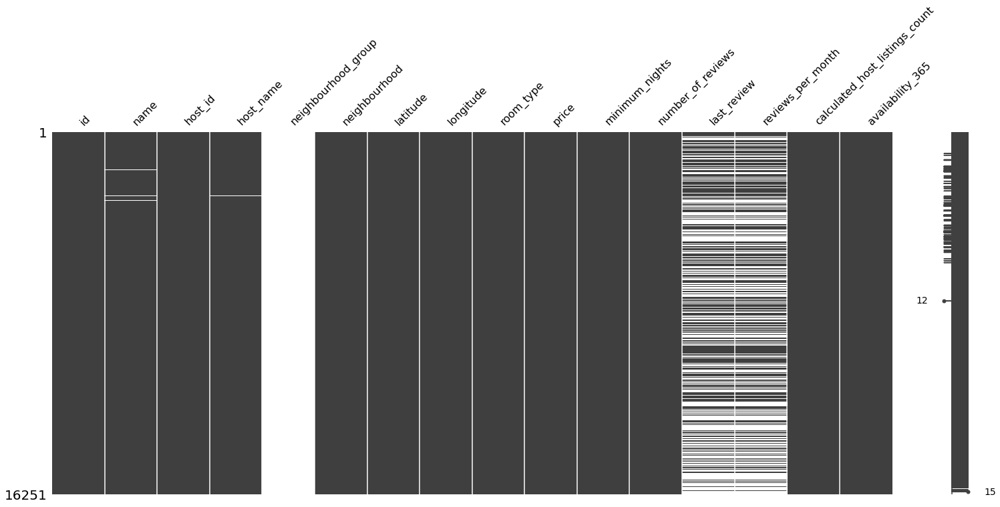

In [11]:
msno.matrix(df)

In [12]:
df.drop("neighbourhood_group",axis=1,inplace=True)

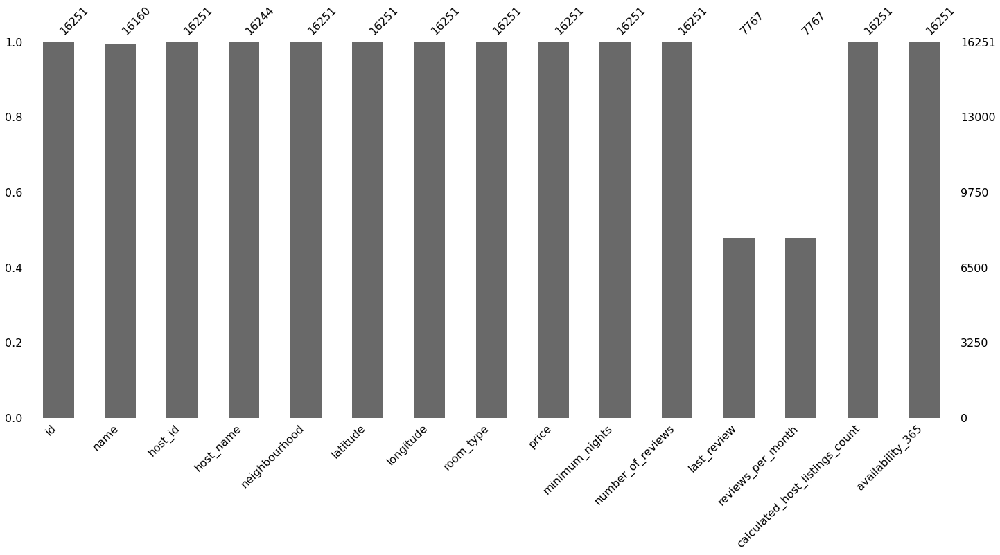

In [13]:
msno.bar(df)

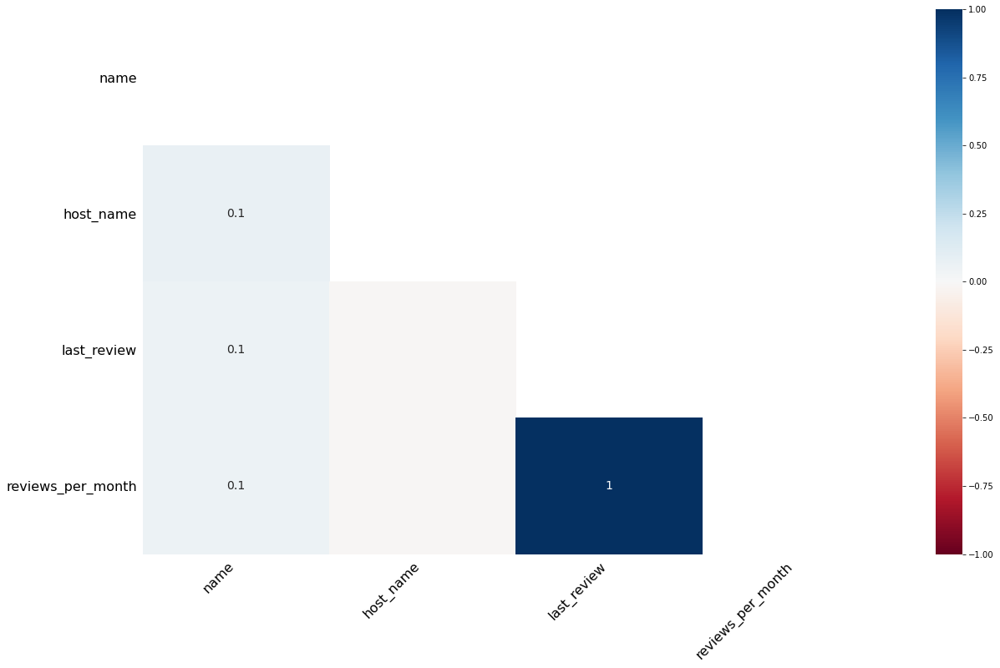

In [14]:
msno.heatmap(df)

In [15]:
df.eq(0).sum().to_frame()

,0
id,0
name,0
host_id,0
host_name,0
neighbourhood,0
latitude,0
longitude,0
room_type,0
price,3
minimum_nights,0


In [16]:
m = folium.Map([42 ,29], zoom_start=5,width="%100",height="%100")
locations = list(zip(df.latitude, df.longitude))
#icons = [folium.Icon(icon="airbnb", prefix="fa") for i in range(len(locations))]

cluster = plugins.MarkerCluster(locations=locations,popups=df["neighbourhood"].tolist())
m.add_child(cluster)
m

In [17]:
m = folium.Map(location=[41,29],width="%100",height="%100")
for i in range(len(locations)):
    folium.CircleMarker(location=locations[i],radius=1).add_to(m)
m

In [18]:
airbnb=df[["latitude","longitude","price"]]
min_price=df["price"].min()
max_price=df["price"].max()
min_price,max_price

(0, 59561)

In [19]:
df.price.describe().to_frame()

,price
count,16251.000000
mean,354.723894
std,1428.938340
min,0.000000
25%,105.000000
50%,190.000000
75%,327.000000
max,59561.000000


In [20]:
m = folium.Map(location=[41,29],width="%100",height="%100")
#colormap = cm.LinearColormap(['green', 'yellow', 'red'],vmin=min_price, vmax=max_price)
colormap = cm.StepColormap(colors=['green','yellow','orange','red'] ,index=[min_price,105,190,327,max_price],vmin= min_price,vmax=max_price)
#cm.LinearColormap.to_step

for loc, p in zip(zip(airbnb["latitude"],airbnb["longitude"]),airbnb["price"]):
    folium.Circle(
        location=loc,
        radius=2,
        fill=True,
        color=colormap(p),
        #popup=
        #fill_opacity=0.7
    ).add_to(m)
#colormap.caption = 'Colormap Caption'
#m.add_child(colormap)

m

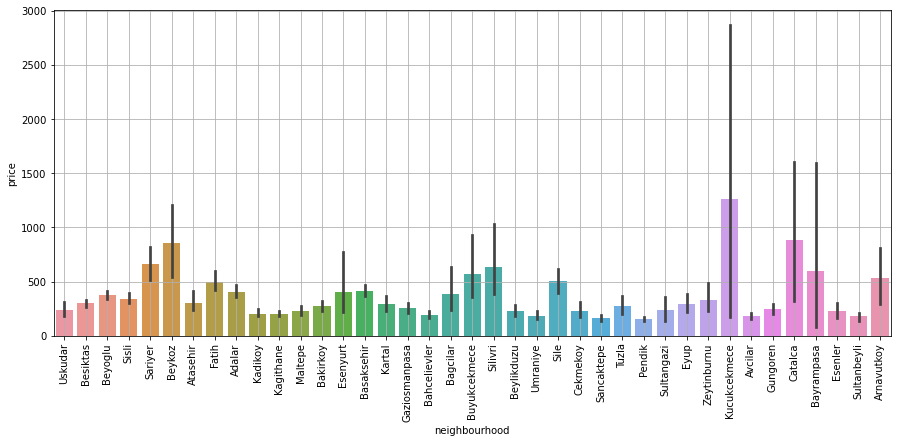

In [21]:
plt.figure(figsize=(15,6))
sns.barplot(x="neighbourhood",y="price",data=df)
plt.xticks(rotation=90);
plt.grid();

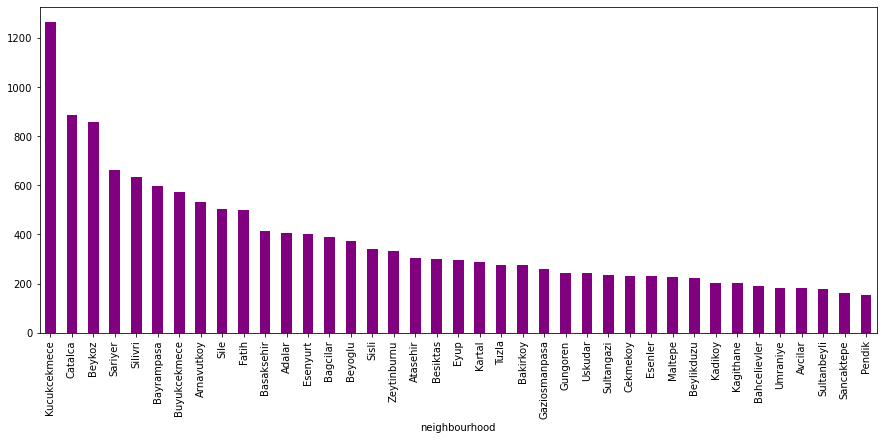

In [22]:
plt.figure(figsize=(15,6))
df.groupby("neighbourhood")["price"].mean().sort_values(ascending=False).plot.bar(color="purple");

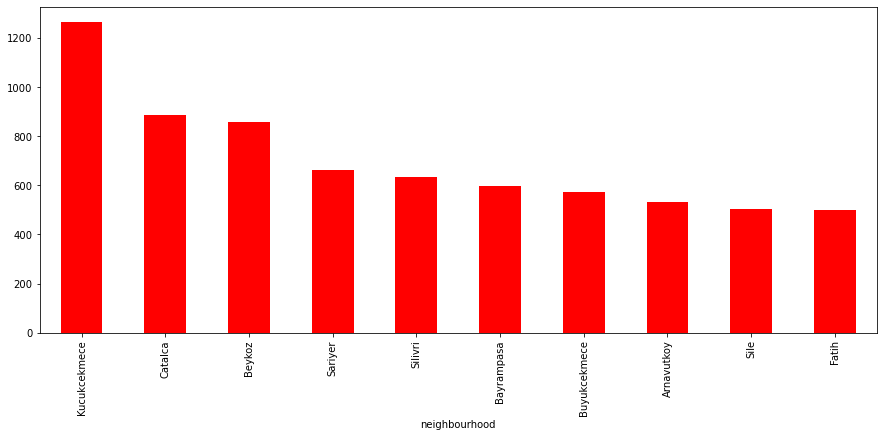

In [23]:
plt.figure(figsize=(15,6))
df.groupby("neighbourhood")["price"].mean().nlargest(10).plot.bar(color="r")

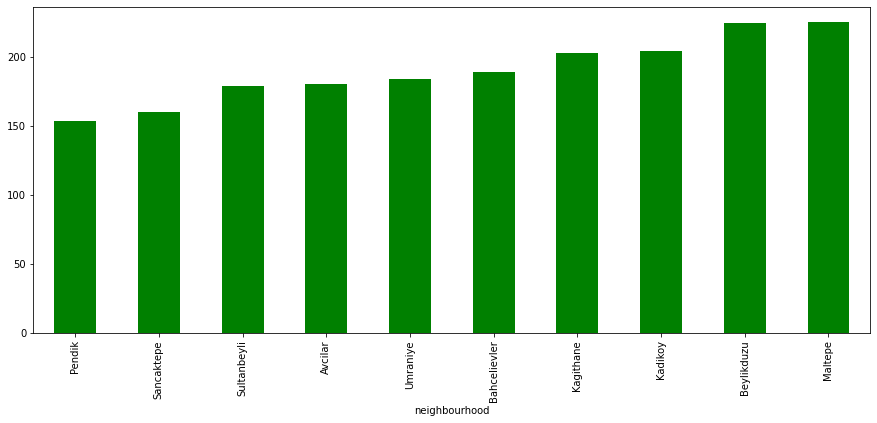

In [24]:
plt.figure(figsize=(15,6))
df.groupby("neighbourhood")["price"].mean().nsmallest(10).plot.bar(color="g")

In [25]:
df.loc[df.price==0,:]

,id,name,host_id,host_name,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
7770,20721123,Stunning Loft Apt. in the Heart of Old City,76368690,İlkan,Beyoglu,41.03073,28.97332,Entire home/apt,0,15,1,2017-10-15,0.06,10,338
7903,21067497,Economic Flat Central&History Istanbul/Taksim,67359125,Eminönü,Beyoglu,41.03455,28.97219,Entire home/apt,0,2,65,2019-02-06,3.96,7,310
7942,21172230,Economic Apartment Taksim Central&History/ista...,67359125,Eminönü,Beyoglu,41.03534,28.97225,Entire home/apt,0,2,46,2019-02-12,2.80,7,302


In [26]:
df[df.neighbourhood=="Beyoglu"]["price"].describe()

count     4245.000000
mean       373.177150
std       1262.097759
min          0.000000
25%        142.000000
50%        227.000000
75%        359.000000
max      52000.000000
Name: price, dtype: float64

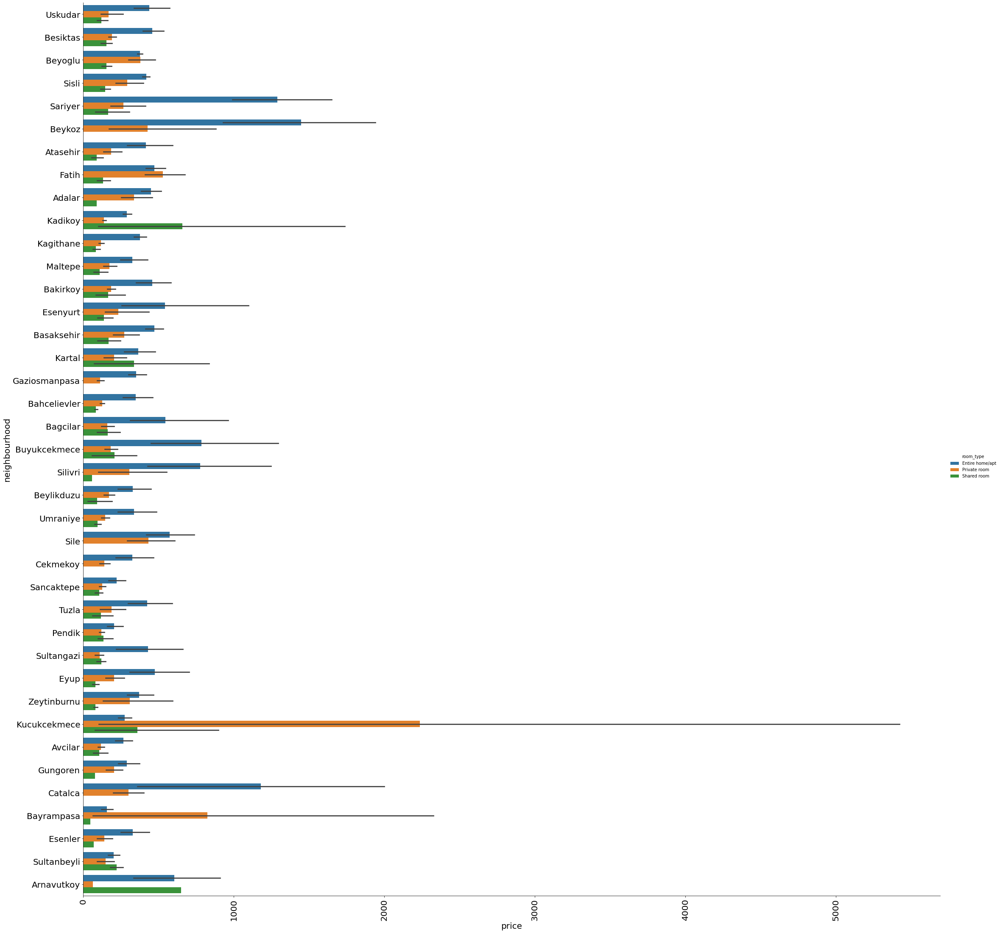

In [27]:

sns.catplot(x="price",y="neighbourhood",hue="room_type",data=df,kind="bar",height=30).set_yticklabels(fontsize=20).set_xticklabels(fontsize=20).set_xlabels(fontsize=20).set_ylabels(fontsize=20)
plt.xticks(rotation=90);

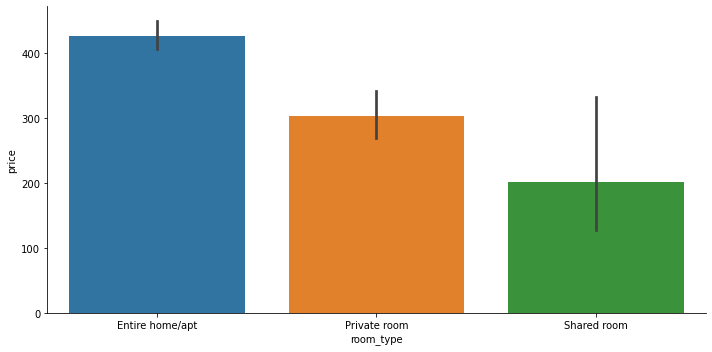

In [28]:
sns.catplot(x="room_type",y="price",data=df,kind="bar",aspect=2);

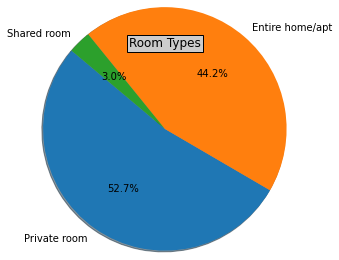

In [29]:
plt.subplot(121)
plt.pie(df["room_type"].value_counts(),
        labels=df.room_type.value_counts().index,
        shadow=True,
        autopct='%1.1f%%',
        radius=2,
        startangle=140);
plt.title("Room Types", 
          bbox={'facecolor':'0.8', 'pad':2},loc="center");
plt.show();

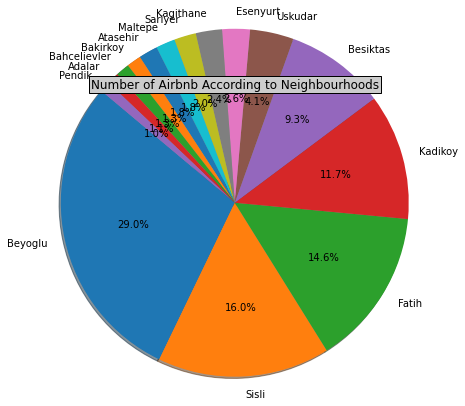

In [30]:

plt.pie(df["neighbourhood"].value_counts().nlargest(15),
        labels=df.neighbourhood.value_counts().index[:15],
        shadow=True,
        autopct='%1.1f%%',
        radius=2,
        startangle=140);
plt.title("Number of Airbnb According to Neighbourhoods", 
          bbox={'facecolor':'0.8', 'pad':2},loc="center");
plt.show();

In [31]:
corr=df[["minimum_nights","number_of_reviews","reviews_per_month","calculated_host_listings_count","availability_365","price"]].corr().abs()
corr

,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365,price
minimum_nights,1.000000,0.015149,0.036223,0.020916,0.015297,0.016585
number_of_reviews,0.015149,1.000000,0.496183,0.174663,0.043230,0.019262
reviews_per_month,0.036223,0.496183,1.000000,0.051228,0.063728,0.032012
calculated_host_listings_count,0.020916,0.174663,0.051228,1.000000,0.173068,0.030100
availability_365,0.015297,0.043230,0.063728,0.173068,1.000000,0.047015
price,0.016585,0.019262,0.032012,0.030100,0.047015,1.000000


In [32]:
print("Unique Host Name Number :",df.host_name.nunique())

Unique Host Name Number : 3797


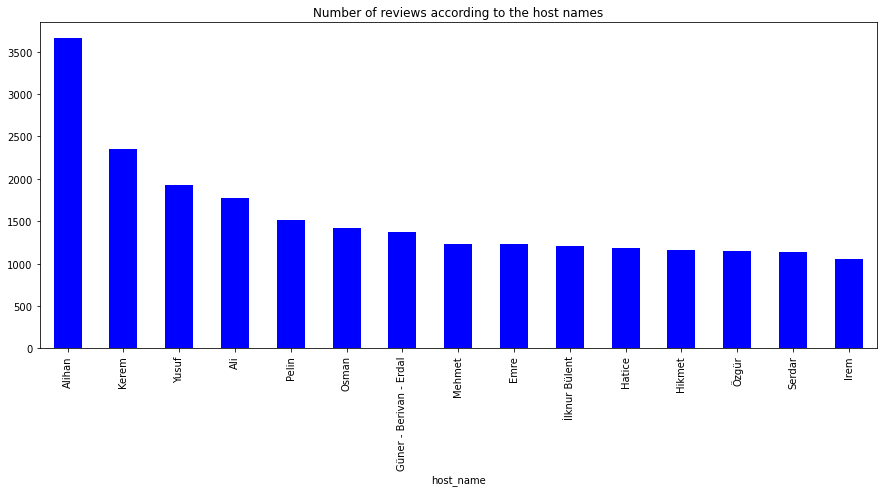

In [33]:
plt.figure(figsize=(15,6))
df.groupby("host_name")["number_of_reviews"].sum().sort_values(ascending=False).nlargest(15).plot.bar(color="b");
plt.title("Number of reviews according to the host names");

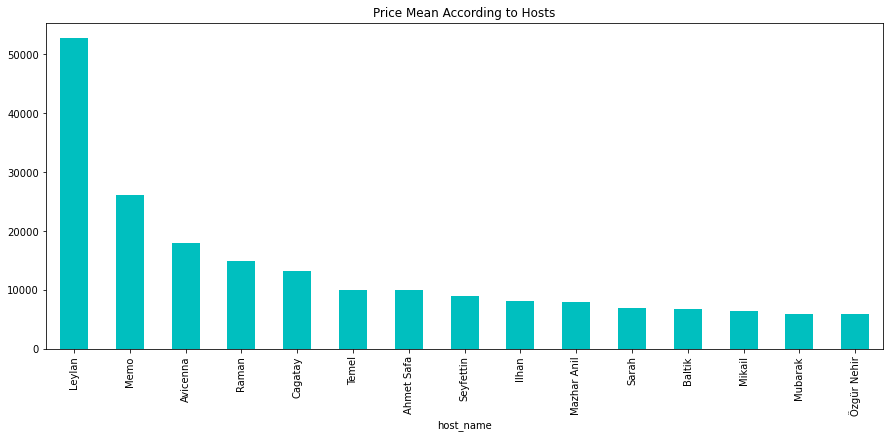

In [34]:
plt.figure(figsize=(15,6))
df.groupby("host_name")["price"].mean().sort_values(ascending=False).nlargest(15).plot.bar(color="c");
plt.title("Price Mean According to Hosts");

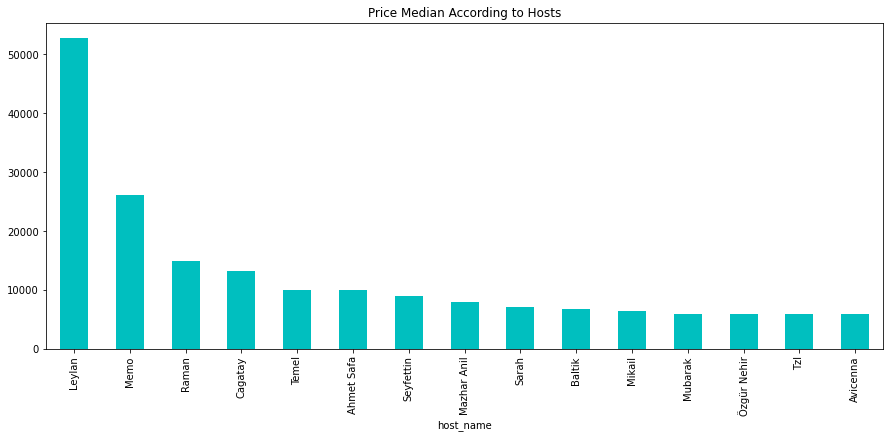

In [35]:
plt.figure(figsize=(15,6))
df.groupby("host_name")["price"].median().sort_values(ascending=False).nlargest(15).plot.bar(color="c");
plt.title("Price Median According to Hosts");

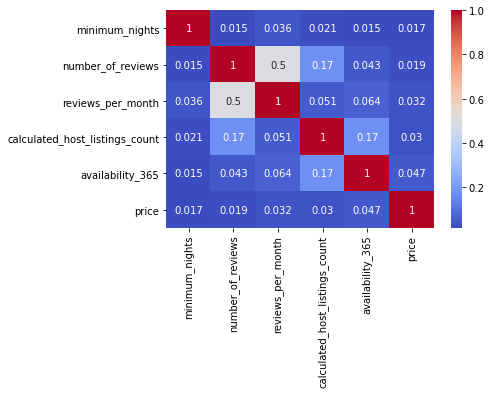

In [36]:
sns.heatmap(corr,annot=True,cmap="coolwarm");